Evraz AI Challenge
---

29-31 октября 2021 г

**Трек 1: Продуйте металл через Data Science**. 

Разработайте модель, прогнозирующую содержание углерода и температуру чугуна во время процесса продувки металла

https://hackathon.evraz.com/

Auto EDA
---

**Исходные данные**

В рамках этой задачи вам будут даны данные о продувки чугуна в цехе:

- **produv** – Таблица содержит основные параметры продувки - мгновенный расход кислорода и положение (наклон) фурмы
- **lom** – Вместе с чугуном в фурму засыпают лом - это часть технологического процесса. Таблица содержит вес и тип ломов, использованных в каждой плавке
- **plavki** – Основная информация по плавке - характеристики плавки (марка металла, направление разливки) и оборудования
- **sip** – Сыпучие добавки, используемые в технологическом процессе
- **chronom** – хронометраж - время начала и конца различных операций во время плавки
- **chugun** – Химический состав и характеристики чугуна
- **gas** – Информация об анализе отходящих газов
- **target** – целевые значения


- [описание задачи](https://russianhackers.notion.site/1-Data-Science-4cc89ba42de1429bbac316f59bf07a3b)
- [атрибутный состав данных](https://russianhackers.notion.site/a685453e4fde41a098d9ad704d906e21?v=c482eaeb8f3143d58763b4b9008f1fec)


In [1]:
# установка https://dataprep.ai/
#!pip install -U dataprep

In [2]:
from dataprep.eda import plot, plot_correlation, create_report, plot_missing
import pandas as pd
from pathlib2 import Path

NumExpr defaulting to 8 threads.


In [3]:
path = Path('../../../data/2021_evraz')

## chronom: хронометраж - время начала и конца различных операций во время плавки

- NPLV	- номер плавки
- TYPE_OPER	- тип операции
- NOP	- наименование операции
- VR_NACH	- время начала операции
- VR_KON	- время окончания операции
- O2	- количество кислорода, израсходованное на операцию

In [4]:
chronom_train = pd.read_csv(path.joinpath('chronom_train.csv'), index_col=0)
chronom_train

,NPLV,TYPE_OPER,NOP,VR_NACH,VR_KON,O2
35171,510008,межпл.прост.,межпл. простой,2011-01-01 10:28:13,2011-01-01 10:32:15,NaN
35162,510008,межпл.прост.,межпл. простой,2021-01-01 03:01:07,2021-01-01 03:08:11,NaN
35163,510008,межпл.прост.,Осмотр конвертера,2021-01-01 03:01:19,2021-01-01 03:03:43,NaN
35164,510008,межпл.прост.,Наведение гарнисажа,2021-01-01 03:03:43,2021-01-01 03:05:23,NaN
35165,510008,межпл.прост.,Слив шлака,2021-01-01 03:05:23,2021-01-01 03:06:09,NaN
...,...,...,...,...,...,...
20943,512322,опер,Повалка,2021-04-26 18:31:26,2021-04-26 18:41:10,NaN
20944,512322,опер,Выпуск металла,2021-04-26 18:41:10,2021-04-26 18:47:40,NaN
20945,512322,опер,Отсечка шлака,2021-04-26 18:46:15,2021-04-26 18:46:15,NaN
20946,512322,опер,Прерыв. выпуска,2021-04-26 18:47:40,2021-04-26 18:48:40,NaN


In [35]:
chronom_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 34406 entries, 35171 to 20947
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   NPLV       34406 non-null  int64  
 1   TYPE_OPER  34406 non-null  object 
 2   NOP        34406 non-null  object 
 3   VR_NACH    34406 non-null  object 
 4   VR_KON     34390 non-null  object 
 5   O2         2916 non-null   float64
dtypes: float64(1), int64(1), object(4)
memory usage: 1.8+ MB


  0%|                                                                                          | 0/224 [00:00<…


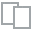
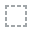
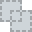
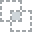
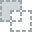
...
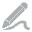
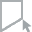
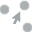
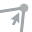
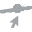

In [5]:
plot(chronom_train)

In [6]:
chronom_test = pd.read_csv(path.joinpath('chronom_test.csv'), index_col=0)
chronom_test

,NPLV,TYPE_OPER,NOP,VR_NACH,VR_KON,O2
0,512324,межпл.прост.,межпл. простой,2011-05-07 21:28:59,2011-05-07 21:33:38,NaN
1,512324,межпл.прост.,межпл. простой,2021-05-05 17:35:55,2021-05-05 17:41:21,NaN
2,512324,межпл.прост.,Осмотр конвертера,2021-05-05 17:36:07,2021-05-05 17:39:07,NaN
3,512324,межпл.прост.,Слив шлака,2021-05-05 17:39:07,2021-05-05 17:41:20,NaN
4,512324,опер,Завалка лома,2021-05-05 17:41:21,2021-05-05 17:43:16,NaN
...,...,...,...,...,...,...
7840,513374,опер,Завалка лома,2021-06-29 22:43:02,2021-06-29 22:43:54,NaN
7841,513374,опер,Нагрев лома,2021-06-29 22:43:54,2021-06-29 22:49:59,NaN
7842,513374,опер,Нагрев лома,2021-06-29 22:43:54,2021-06-29 22:49:59,1797.0
7843,513374,опер,Заливка чугуна,2021-06-29 22:50:07,2021-06-29 22:53:43,NaN


In [36]:
chronom_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7845 entries, 0 to 7844
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   NPLV       7845 non-null   int64  
 1   TYPE_OPER  7845 non-null   object 
 2   NOP        7845 non-null   object 
 3   VR_NACH    7845 non-null   object 
 4   VR_KON     7845 non-null   object 
 5   O2         252 non-null    float64
dtypes: float64(1), int64(1), object(4)
memory usage: 429.0+ KB


  0%|                                                                                          | 0/224 [00:00<…


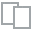
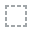
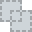
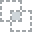
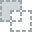
...
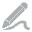
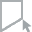
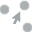
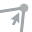
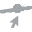

In [7]:
plot(chronom_test)

## chugun: химический состав и характеристики чугуна

- NPLV	- номер плавки
- VES	- вес чугуна
- T	- температура чугуна
- SI	- SI вчугуне
- MN	- MN в чугуне
- S	- S в чугуне
- P	 - P в чугуне
- CR	- CR в чугуне
- NI	- NI в чугуне
- CU	- CU в чугуне

In [8]:
chugun_train = pd.read_csv(path.joinpath('chugun_train.csv'))
chugun_train

,NPLV,VES,T,SI,MN,S,P,CR,NI,CU,V,TI,DATA_ZAMERA
0,510008,263700.0,1396.0,0.44,0.22,0.023,0.097,0.03,0.01,0.03,0.103,0.084,2021-01-01 03:15:03
1,510009,264500.0,1419.0,0.68,0.20,0.017,0.087,0.02,0.01,0.03,0.084,0.096,2021-01-01 04:23:48
2,510010,263800.0,1384.0,0.56,0.26,0.017,0.096,0.03,0.01,0.03,0.115,0.110,2021-01-01 05:21:40
3,510011,264000.0,1401.0,0.48,0.27,0.018,0.091,0.03,0.01,0.02,0.112,0.110,2021-01-01 06:20:57
4,510012,263300.0,1422.0,0.47,0.23,0.018,0.096,0.02,0.01,0.03,0.083,0.070,2021-01-01 07:23:02
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,512318,267200.0,1415.0,0.38,0.28,0.019,0.099,0.02,0.01,0.02,0.081,0.060,2021-04-26 12:53:40
2059,512319,266800.0,1405.0,0.50,0.30,0.017,0.104,0.02,0.01,0.02,0.079,0.081,2021-04-26 14:21:57
2060,512320,276100.0,1398.0,0.61,0.31,0.025,0.115,0.03,0.01,0.03,0.086,0.066,2021-04-26 14:33:29
2061,512321,275800.0,1408.0,0.38,0.27,0.021,0.100,0.02,0.01,0.03,0.076,0.060,2021-04-26 15:50:53


In [39]:
type(chugun_train.iloc[0,-1])

str

In [37]:
chugun_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2063 entries, 0 to 2062
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   NPLV         2063 non-null   int64  
 1   VES          2063 non-null   float64
 2   T            2063 non-null   float64
 3   SI           2063 non-null   float64
 4   MN           2063 non-null   float64
 5   S            2063 non-null   float64
 6   P            2063 non-null   float64
 7   CR           2063 non-null   float64
 8   NI           2063 non-null   float64
 9   CU           2063 non-null   float64
 10  V            2063 non-null   float64
 11  TI           2063 non-null   float64
 12  DATA_ZAMERA  2063 non-null   object 
dtypes: float64(11), int64(1), object(1)
memory usage: 209.6+ KB


  0%|                                                                                          | 0/697 [00:00<…


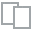
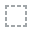
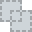
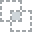
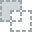
...
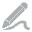
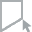
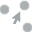
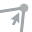
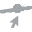

In [9]:
plot(chugun_train)

In [10]:
chugun_test = pd.read_csv(path.joinpath('chugun_test.csv'))
chugun_test

,NPLV,VES,T,SI,MN,S,P,CR,NI,CU,V,TI,DATA_ZAMERA
0,512324,240100.0,1355.0,0.46,0.33,0.027,0.079,0.01,0.01,0.02,0.048,0.030,2021-05-05 17:22:54
1,512327,266400.0,1390.0,0.30,0.33,0.032,0.099,0.01,0.00,0.00,0.050,0.024,2021-05-05 20:00:30
2,512328,270200.0,1373.0,0.00,0.00,0.000,0.000,0.00,0.00,0.00,0.000,0.000,2021-05-05 22:29:21
3,512331,266700.0,1383.0,0.54,0.39,0.028,0.115,0.02,0.01,0.03,0.059,0.042,2021-05-06 01:58:11
4,512333,267400.0,1387.0,0.00,0.00,0.000,0.000,0.00,0.00,0.00,0.000,0.000,2021-05-06 05:27:08
...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,513369,280800.0,1324.0,0.35,0.29,0.035,0.096,0.01,0.01,0.02,0.080,0.062,2021-06-29 16:51:30
776,513370,280600.0,1389.0,0.39,0.31,0.024,0.097,0.01,0.01,0.02,0.093,0.074,2021-06-29 17:35:57
777,513371,279700.0,1332.0,0.30,0.27,0.031,0.099,0.01,0.01,0.02,0.066,0.036,2021-06-29 18:52:34
778,513372,279700.0,1378.0,0.43,0.33,0.026,0.113,0.01,0.01,0.02,0.095,0.070,2021-06-29 19:42:11


  0%|                                                                                          | 0/697 [00:00<…


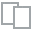
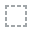
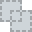
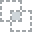
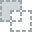
...
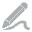
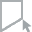
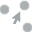
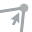
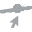

In [11]:
plot(chugun_test)

## gas: информация об анализе отходящих газов

- O2_pressure -	Давление кислорода	Фактически этот признак относится к  параметрам продувки
- T фурмы 2 -	Температура 2-ой фурмы	
- T фурмы 1 -	Температура 1-ой фурмы	В каждый момент времени активна только одна фурма, поэтому ее температура больше
- AR -	доля AR в отх. газах 	
- CO -	доля CO в отх. газах 	
- CO2 -	доля CO2 в отх. газах 	
- H2 -	доля H2 в отх. газах 	
- N2 -	доля N2 в отх. газах 	
- O2 -	доля O2 в отх. газах 	
- T -	температура отходящих газов	
- V -	объем выходящих газов	
- NPLV -	номер плавки	
- Time -	дата и время замера хим. состава отходящих газов. Информация об анализе отходящих газов

In [12]:
gas_train = pd.read_csv(path.joinpath('gas_train.csv'))
gas_train

,NPLV,Time,V,T,O2,N2,H2,CO2,CO,AR,T фурмы 1,T фурмы 2,O2_pressure
0,510008,2021-01-01 03:08:11.437,218263.343750,262.847229,18.722993,80.132247,0.087755,0.163878,9.229025e-03,0.893243,0.000000,0.000000,13.085938
1,510008,2021-01-01 03:08:12.437,218263.343750,262.847229,18.732721,80.138406,0.087959,0.148980,8.390023e-03,0.892948,0.000000,0.000000,13.085938
2,510008,2021-01-01 03:08:13.437,218369.359375,262.152771,18.742449,80.144565,0.088163,0.134082,7.551021e-03,0.892653,0.000000,0.000000,13.085938
3,510008,2021-01-01 03:08:14.437,218475.359375,261.805573,18.752177,80.150724,0.088367,0.119184,6.712018e-03,0.892358,0.000000,0.000000,13.093172
4,510008,2021-01-01 03:08:15.437,218369.359375,260.763885,18.761905,80.156883,0.088571,0.104286,5.873016e-03,0.892063,0.000000,0.000000,13.093172
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6468013,512322,2021-04-26 18:48:35.437,207386.734375,118.402779,1.890000,97.220001,0.090000,0.050000,0.000000e+00,0.750000,23.900463,27.054343,14.424190
6468014,512322,2021-04-26 18:48:36.437,207051.609375,118.402779,2.710000,96.410004,0.080000,0.040000,0.000000e+00,0.770000,23.900463,27.054342,14.424190
6468015,512322,2021-04-26 18:48:37.437,207163.375000,118.402779,3.770000,95.349998,0.090000,0.030000,0.000000e+00,0.770000,23.900463,27.054341,14.438658
6468016,512322,2021-04-26 18:48:38.437,206827.906250,118.750000,3.400000,95.720001,0.090000,0.040000,0.000000e+00,0.750000,23.900463,27.054340,14.445890


  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                           | 0/20 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                         | 0/2764 [00:00<…


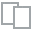
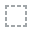
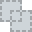
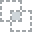
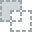
...
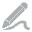
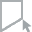
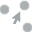
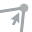
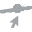

In [13]:
plot(gas_train)

In [14]:
gas_test = pd.read_csv(path.joinpath('gas_test.csv'))
gas_test

,NPLV,Time,V,T,O2,N2,H2,CO2,CO,AR,T фурмы 1,T фурмы 2,O2_pressure
0,512324,2021-05-05 17:41:21.437,213979.046875,137.326396,18.671576,79.388503,0.153247,0.591429,0.216998,0.980324,26.244215,26.673637,16.124132
1,512324,2021-05-05 17:41:22.437,214303.343750,137.413201,18.678876,79.386573,0.153680,0.585952,0.216933,0.980043,26.244215,26.673768,16.124132
2,512324,2021-05-05 17:41:23.437,214842.750000,137.500007,18.686176,79.384642,0.154113,0.580476,0.216868,0.979762,26.244215,26.673900,16.124132
3,512324,2021-05-05 17:41:24.437,214842.750000,137.586812,18.693477,79.382712,0.154545,0.575000,0.216803,0.979482,26.244215,26.674031,16.124132
4,512324,2021-05-05 17:41:25.437,215273.281250,137.673618,18.700777,79.380781,0.154978,0.569524,0.216739,0.979201,26.244215,26.674163,16.124132
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2515863,513374,2021-06-29 23:29:03.437,232936.171875,141.319443,5.410000,81.769997,0.050000,11.600000,0.000000,1.160000,30.005785,30.295139,16.059027
2515864,513374,2021-06-29 23:29:04.437,232737.328125,141.319443,5.410000,81.769997,0.050000,11.600000,0.000000,1.160000,30.005785,30.295139,16.059027
2515865,513374,2021-06-29 23:29:05.437,232239.515625,142.013885,5.410000,81.769997,0.050000,11.600000,0.000000,1.160000,30.005785,30.295139,16.066261
2515866,513374,2021-06-29 23:29:06.437,232139.796875,142.361115,5.410000,81.769997,0.050000,11.600000,0.000000,1.160000,30.005785,30.295139,16.066261


  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                         | 0/1563 [00:00<…


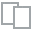
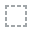
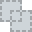
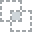
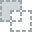
...
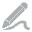
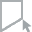
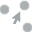
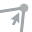
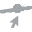

In [15]:
plot(gas_test)

## lom: вес и тип ломов в  плавке

Вместе с чугуном в фурму засыпают лом - это часть технологического процесса. Таблица содержит вес и тип ломов, использованных в каждой плавке

- NPLV	- номер плавки
- VDL	- код лома
- NML	- наименование лома
- VES	- вес лома

In [16]:
lom_train = pd.read_csv(path.joinpath('lom_train.csv'))
lom_train

,NPLV,VDL,NML,VES
0,510008,4,К,56500
1,510008,8,О,16700
2,510008,13,КП,3000
3,510009,4,К,49800
4,510009,8,О,22800
...,...,...,...,...
6371,512321,8,О,4200
6372,512321,13,КП,3000
6373,512322,4,К,66700
6374,512322,13,КП,6000


  0%|                                                                                          | 0/196 [00:00<…


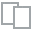
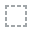
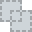
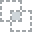
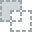
...
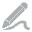
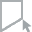
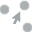
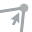
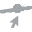

In [17]:
plot(lom_train)

In [18]:
lom_test = pd.read_csv(path.joinpath('lom_test.csv'))
lom_test

,NPLV,VDL,NML,VES
0,512324,4,К,26040
1,512324,8,О,17660
2,512324,13,КП,2000
3,512327,8,О,10600
4,512327,23,ЛЧ,8000
...,...,...,...,...
2627,513372,48,У2КШ,500
2628,513374,4,К,54400
2629,513374,13,КП,7000
2630,513374,8,О,9100


  0%|                                                                                          | 0/196 [00:00<…


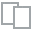
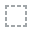
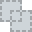
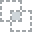
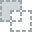
...
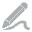
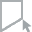
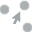
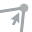
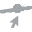

In [19]:
plot(lom_train)

## plavki: характеристики плавки (марка металла, направление разливки) и оборудования

Основная информация по плавке - характеристики плавки (марка металла, направление разливки) и оборудования

- NPLV -	номер плавки
- plavka_VR_NACH -	время начала плавки
- plavka_VR_KON -	время окончания плавки
- plavka_NMZ -	марка заданная 
- plavka_NAPR_ZAD -	направление разливки
- plavka_STFUT -	стойкость футеровки конвертера
- plavka_TIPE_FUR -	тип фурмы
- plavka_ST_FURM -	стойкость фурмы
- plavka_TIPE_GO -L	тип головки фурмы
- plavka_ST_GOL -	стойкость головки фурмы

In [20]:
plavki_train = pd.read_csv(path.joinpath('plavki_train.csv'))
plavki_train

,NPLV,plavka_VR_NACH,plavka_VR_KON,plavka_NMZ,plavka_NAPR_ZAD,plavka_STFUT,plavka_TIPE_FUR,plavka_ST_FURM,plavka_TIPE_GOL,plavka_ST_GOL
0,510008,2021-01-01 03:08:11,2021-01-01 03:51:10,С255,МНЛЗ,971,цилиндрическая,11,5 сопловая,11
1,510009,2021-01-01 04:00:44,2021-01-01 05:07:28,С255,МНЛЗ,972,цилиндрическая,12,5 сопловая,12
2,510010,2021-01-01 05:12:29,2021-01-01 06:00:53,Ст3пс/Э,Изл,973,цилиндрическая,13,5 сопловая,13
3,510011,2021-01-01 06:13:48,2021-01-01 07:08:39,Св-08А.z02,Изл,974,цилиндрическая,14,5 сопловая,14
4,510012,2021-01-01 07:13:44,2021-01-01 08:01:59,SC2M/ЭТ,МНЛС,975,цилиндрическая,15,5 сопловая,15
...,...,...,...,...,...,...,...,...,...,...
2132,512318,2021-04-26 13:04:26,2021-04-26 13:55:50,C071TM.z01/ЭТ,МНЛС,3281,коническая,22,5 сопловая,56
2133,512319,2021-04-26 14:10:20,2021-04-26 15:14:23,C071TM.z01/ЭТ,МНЛС,3282,коническая,23,5 сопловая,57
2134,512320,2021-04-26 15:21:37,2021-04-26 16:16:42,40Х.1,МНЛЗ,3283,коническая,24,5 сопловая,58
2135,512321,2021-04-26 16:22:37,2021-04-26 17:23:37,40Х.1,МНЛЗ,3284,коническая,25,5 сопловая,59


  0%|                                                                                          | 0/396 [00:00<…


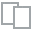
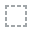
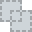
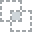
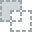
...
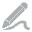
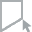
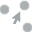
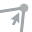
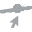

In [21]:
plot(plavki_train)

In [22]:
plavki_test = pd.read_csv(path.joinpath('plavki_test.csv'))
plavki_test

,NPLV,plavka_VR_NACH,plavka_VR_KON,plavka_NMZ,plavka_NAPR_ZAD,plavka_STFUT,plavka_TIPE_FUR,plavka_ST_FURM,plavka_TIPE_GOL,plavka_ST_GOL
0,512324,2021-05-05 17:41:21,2021-05-05 18:46:07,Ст3пс/Э,Изл,2,цилиндрическая,2,4-сопл х54,2
1,512327,2021-05-05 21:07:01,2021-05-05 22:02:26,C121TM/ЭТ,МНЛС,5,цилиндрическая,5,4-сопл х54,5
2,512328,2021-05-05 22:03:12,2021-05-05 23:39:32,Ст3пс/Э,Изл,6,цилиндрическая,6,4-сопл х54,6
3,512331,2021-05-06 02:21:46,2021-05-06 03:49:18,25Г2С,Изл,9,цилиндрическая,9,4-сопл х54,9
4,512333,2021-05-06 05:22:03,2021-05-06 06:25:51,C091TM.z01/ЭТ,МНЛС,11,цилиндрическая,11,4-сопл х54,11
...,...,...,...,...,...,...,...,...,...,...
775,513369,2021-06-29 17:08:33,2021-06-29 17:55:50,Ст3сп/Т,МНЛЗ,1047,цилиндрическая,2,601-5,2
776,513370,2021-06-29 18:03:00,2021-06-29 18:49:50,Ст3сп/Т,МНЛЗ,1048,цилиндрическая,3,601-5,3
777,513371,2021-06-29 18:55:21,2021-06-29 19:53:39,Ст3сп/Т,МНЛЗ,1049,цилиндрическая,4,601-5,4
778,513372,2021-06-29 20:18:40,2021-06-29 20:59:18,Ст3сп/Т,МНЛЗ,1050,цилиндрическая,5,601-5,5


  0%|                                                                                          | 0/396 [00:00<…


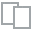
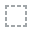
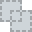
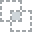
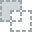
...
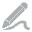
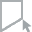
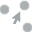
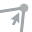
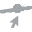

In [23]:
plot(plavki_test)

## produv: параметры продувки - мгновенный расход кислорода и положение (наклон) фурмы

Таблица содержит основные параметры продувки - мгновенный расход кислорода и положение (наклон) фурмы

- NPLV	- номер плавки
- SEC	- время измерения
- RAS	- расход кислорода на продувку
- POL	- положение фурмы для продувки

In [24]:
produv_train = pd.read_csv(path.joinpath('produv_train.csv'))
produv_train

,NPLV,SEC,RAS,POL
0,510008,2021-01-01 03:18:26,382.000000,3.920000
1,510008,2021-01-01 03:18:28,382.000000,3.920000
2,510008,2021-01-01 03:18:30,553.000000,3.920000
3,510008,2021-01-01 03:18:32,701.000000,3.920000
4,510008,2021-01-01 03:18:34,813.000000,3.920000
...,...,...,...,...
4729797,512322,2021-05-05 16:30:46,363.996249,4.850045
4729798,512322,2021-05-05 16:30:48,363.996999,4.850036
4729799,512322,2021-05-05 16:30:50,363.997749,4.850027
4729800,512322,2021-05-05 16:30:52,363.998499,4.850018


  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

  0%|                                                                                            | 0/9 [00:00<…

100%|############################################################################################| 4/4 [00:00<…

  0%|                                                                                          | 0/393 [00:00<…


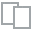
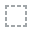
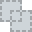
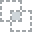
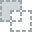
...
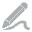
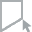
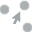
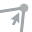
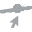

In [25]:
plot(produv_train)

In [26]:
produv_test = pd.read_csv(path.joinpath('produv_test.csv'))
produv_test

,NPLV,SEC,RAS,POL
0,512324,2021-05-05 17:43:18,181.0,4.20
1,512324,2021-05-05 17:43:20,215.0,4.20
2,512324,2021-05-05 17:43:22,243.0,4.20
3,512324,2021-05-05 17:43:24,265.0,4.20
4,512324,2021-05-05 17:43:26,273.0,4.20
...,...,...,...,...
1692372,513374,2021-06-29 23:13:36,186.0,2.94
1692373,513374,2021-06-29 23:13:38,152.0,2.94
1692374,513374,2021-06-29 23:13:40,124.0,2.94
1692375,513374,2021-06-29 23:13:42,101.0,2.94


100%|############################################################################################| 2/2 [00:00<…

  0%|                                                                                          | 0/263 [00:00<…


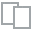
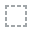
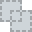
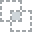
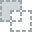
...
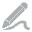
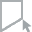
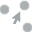
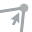
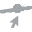

In [27]:
plot(produv_test)

## sip: характеристики плавки (марка металла, направление разливки) и оборудования

Основная информация по плавке - характеристики плавки (марка металла, направление разливки) и оборудования

- NPLV	- номер плавки
- VDSYP	- вид сыпучих
- NMSYP	- наименование сыпучих
- VSSYP	- вес сыпучих
- DAT_OTD	- дата и время отдачи

In [28]:
sip_train = pd.read_csv(path.joinpath('sip_train.csv'))
sip_train

,NPLV,VDSYP,NMSYP,VSSYP,DAT_OTD
0,510008,346,Уголь ТО,570,2021-01-01 03:03:53
1,510008,346,Уголь ТО,220,2021-01-01 03:04:10
2,510008,408,изв_ЦОИ,7300,2021-01-01 03:08:17
3,510008,346,Уголь ТО,270,2021-01-01 03:09:03
4,510008,346,Уголь ТО,430,2021-01-01 03:09:20
...,...,...,...,...,...
31579,512322,408,изв_ЦОИ,30,2021-04-26 18:28:06
31580,512322,408,изв_ЦОИ,490,2021-04-26 18:28:07
31581,512322,408,изв_ЦОИ,20,2021-04-26 18:28:22
31582,512322,408,изв_ЦОИ,970,2021-04-26 18:30:26


  0%|                                                                                          | 0/195 [00:00<…


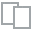
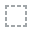
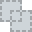
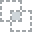
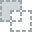
...
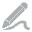
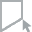
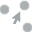
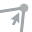
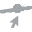

In [29]:
plot(sip_train)

In [30]:
sip_test = pd.read_csv(path.joinpath('sip_test.csv'))
sip_test

,NPLV,VDSYP,NMSYP,VSSYP,DAT_OTD
0,512324,408,изв_ЦОИ,3020,2021-05-05 17:38:59
1,512324,442,ФЛЮМАГ,1670,2021-05-05 17:42:07
2,512324,408,изв_ЦОИ,2810,2021-05-05 17:42:07
3,512324,346,Уголь ТО,140,2021-05-05 17:43:39
4,512324,346,Уголь ТО,70,2021-05-05 17:43:49
...,...,...,...,...,...
10457,513374,346,Уголь ТО,630,2021-06-29 22:44:40
10458,513374,346,Уголь ТО,2310,2021-06-29 22:46:17
10459,513374,408,изв_ЦОИ,10010,2021-06-29 22:46:23
10460,513374,346,Уголь ТО,670,2021-06-29 22:48:22


  0%|                                                                                          | 0/195 [00:00<…


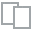
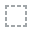
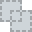
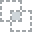
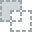
...
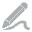
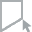
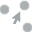
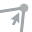
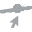

In [31]:
plot(sip_test)

## target: целевые значения

- C	- содержание углерода в металле
- TST	- температура металла
- NPLV	- номер плавки

In [32]:
target_train = pd.read_csv(path.joinpath('target_train.csv'))
target_train

,NPLV,TST,C
0,510008,1690,0.060
1,510009,1683,0.097
2,510010,1662,0.091
3,510011,1609,0.410
4,510012,1682,0.120
...,...,...,...
2058,512318,1626,0.145
2059,512319,1643,0.087
2060,512320,1615,0.141
2061,512321,1654,0.270


  0%|                                                                                          | 0/168 [00:00<…


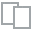
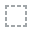
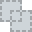
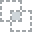
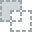
...
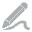
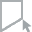
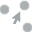
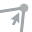
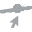

In [33]:
plot(target_train)

In [34]:
target_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2063 entries, 0 to 2062
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   NPLV    2063 non-null   int64  
 1   TST     2063 non-null   int64  
 2   C       2061 non-null   float64
dtypes: float64(1), int64(2)
memory usage: 48.5 KB


# Идеи и выводы

- пропуски:
  - chronom_train имеет 15% пропусков
  - chronom_test 16%
  - targrt_train 2 пропущеных значения.

Идеи

- [ ] C - содержание углерода в металле - распределение скошенно - **логарифмировать**
- [ ] C - содержание углерода в металле - 2 пропущенных значения